In [1]:
pip install pandas

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install matplotlib

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install seaborn

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install scipy

Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.


In [6]:
!pip install --quiet optuna

In [7]:
import pandas as pd
import numpy as np
import optuna
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
from scipy import stats
from sklearn.preprocessing import StandardScaler
from sklearn.svm import OneClassSVM
from sklearn.neighbors import LocalOutlierFactor
from sklearn.ensemble import IsolationForest
import joblib
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix, classification_report




c:\Users\Admin\AppData\Local\Programs\Python\Python313\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Обучать будем на основе обучения без учителя, попробуем 3 вида моделей
OneClassSVM, LocalOutlierFactor, IsolationForest

In [8]:
df = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')

In [9]:
df.head()

,id,Time,feat1,feat2,feat3,feat4,feat5,feat6,feat7,feat8,...,feat21,feat22,feat23,feat24,feat25,feat26,feat27,feat28,Transaction_Amount,IsFraud
0,0,0.0,2.074329,-0.129425,-1.137418,0.412846,-0.192638,-1.210144,0.110697,-0.263477,...,-0.334701,-0.887840,0.336701,-0.110835,-0.291459,0.207733,-0.076576,-0.059577,1.98,0
1,1,0.0,1.998827,-1.250891,-0.520969,-0.894539,-1.122528,-0.270866,-1.029289,0.050198,...,0.054848,-0.038367,0.133518,-0.461928,-0.465491,-0.464655,-0.009413,-0.038238,84.00,0
2,2,0.0,0.091535,1.004517,-0.223445,-0.435249,0.667548,-0.988351,0.948146,-0.084789,...,-0.326725,-0.803736,0.154495,0.951233,-0.506919,0.085046,0.224458,0.087356,2.69,0
3,3,0.0,1.979649,-0.184949,-1.064206,0.120125,-0.215238,-0.648829,-0.087826,-0.035367,...,-0.095514,-0.079792,0.167701,-0.042939,0.000799,-0.096148,-0.057780,-0.073839,1.00,0
4,4,0.0,1.025898,-0.171827,1.203717,1.243900,-0.636572,1.099074,-0.938651,0.569239,...,0.099157,0.608908,0.027901,-0.262813,0.257834,-0.252829,0.108338,0.021051,1.00,0


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 32 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   id                  150000 non-null  int64  
 1   Time                150000 non-null  float64
 2   feat1               150000 non-null  float64
 3   feat2               150000 non-null  float64
 4   feat3               150000 non-null  float64
 5   feat4               150000 non-null  float64
 6   feat5               150000 non-null  float64
 7   feat6               150000 non-null  float64
 8   feat7               150000 non-null  float64
 9   feat8               150000 non-null  float64
 10  feat9               150000 non-null  float64
 11  feat10              150000 non-null  float64
 12  feat11              150000 non-null  float64
 13  feat12              150000 non-null  float64
 14  feat13              150000 non-null  float64
 15  feat14              150000 non-nul

In [11]:
df.duplicated().value_counts()

False    150000
Name: count, dtype: int64

In [12]:
df.describe()

,id,Time,feat1,feat2,feat3,feat4,feat5,feat6,feat7,feat8,...,feat21,feat22,feat23,feat24,feat25,feat26,feat27,feat28,Transaction_Amount,IsFraud
count,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,...,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000
mean,74999.500000,49785.422340,0.069456,-0.003674,0.739860,0.104810,-0.254623,0.151934,-0.165443,0.166254,...,-0.032077,-0.068876,-0.059646,-0.000776,0.161152,0.021575,0.014138,0.020323,71.065194,0.001793
std,43301.414527,18733.655609,1.346553,1.161502,1.012801,1.230909,1.048268,1.182964,0.802668,0.691267,...,0.404916,0.573755,0.323272,0.584270,0.385175,0.473795,0.223692,0.163429,158.712510,0.042310
min,0.000000,0.000000,-22.173926,-44.247914,-19.088980,-5.069484,-21.090735,-25.659750,-31.179799,-28.903442,...,-14.689621,-7.351378,-11.958588,-2.827444,-3.958591,-1.413857,-9.234767,-4.454059,0.000000,0.000000
25%,37499.750000,39411.000000,-0.844248,-0.621724,0.181373,-0.738399,-0.912254,-0.590892,-0.667139,-0.078114,...,-0.185077,-0.464426,-0.177546,-0.321495,-0.078682,-0.310948,-0.044800,0.001623,6.990000,0.000000
50%,74999.500000,53785.000000,0.671327,0.003677,0.826497,0.095342,-0.322525,-0.068690,-0.144551,0.125052,...,-0.044828,-0.045844,-0.068170,0.043048,0.181701,-0.087927,0.017590,0.024098,24.900000,0.000000
75%,112499.250000,63833.000000,1.171271,0.753340,1.360362,0.967657,0.242796,0.492931,0.334553,0.396056,...,0.100896,0.309938,0.047399,0.388969,0.425791,0.269844,0.073776,0.065778,74.000000,0.000000
max,149999.000000,73899.000000,2.390816,16.068473,6.145578,12.547997,34.581260,15.082516,23.256066,18.270586,...,22.062945,6.163541,12.734391,4.572739,3.111624,3.119824,6.457839,23.263746,6513.350000,1.000000


In [13]:
df['IsFraud'].value_counts()

IsFraud
0    149731
1       269
Name: count, dtype: int64

In [14]:
df['Transaction_Amount'].mean()

np.float64(71.06519361435043)

In [15]:
a = df[df['IsFraud'] == 0]['Transaction_Amount']
b = df[df['IsFraud'] == 1]['Transaction_Amount']

ttest = scipy.stats.ttest_ind(a,b, equal_var=False)

ttest


TtestResult(statistic=np.float64(-2.573255889936843), pvalue=np.float64(0.010612741619405274), df=np.float64(268.11155140176226))

In [16]:
a.mean()

np.float64(70.93487983218279)

In [17]:
b.mean()

np.float64(143.60055762081785)

Нулевая гипотеза что средняя значение генеральных совокупностей из которых взяты выборки равны 

Альтернативная то что не равны

На выходе мы получили значение pvalue меньше чем 0.05 что означаем что мы отвергаем нулевую гепотезу

Можно прийти к выводу что с большой долей вероятности а и б не равны.


In [18]:
df[df['Transaction_Amount'] > 500]['IsFraud'].value_counts()


IsFraud
0    2965
1      16
Name: count, dtype: int64

In [19]:
df[df['Transaction_Amount'] < 500]['IsFraud'].value_counts()


IsFraud
0    146621
1       250
Name: count, dtype: int64

In [20]:
16/2965

0.005396290050590219

In [21]:
250/146621

0.0017050763533191017

Хоть в сумме транзакций есть выбросы, из расчетов выше можно сделать вывод что чем больше сумма тем  выше вероятность мошенничество.

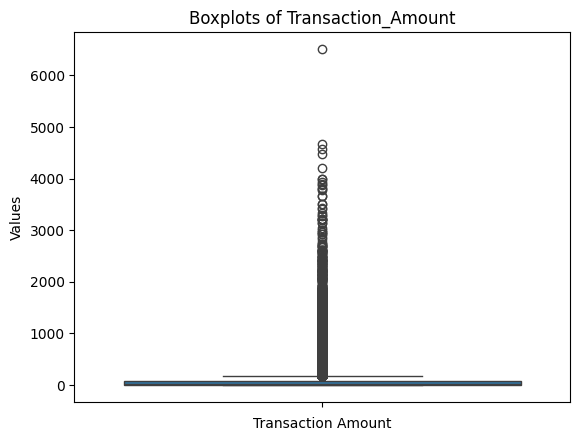

In [22]:
sns.boxplot(df['Transaction_Amount'])
plt.xticks(rotation=90)
plt.title('Boxplots of Transaction_Amount')
plt.xlabel('Transaction Amount')
plt.ylabel('Values')
plt.show()

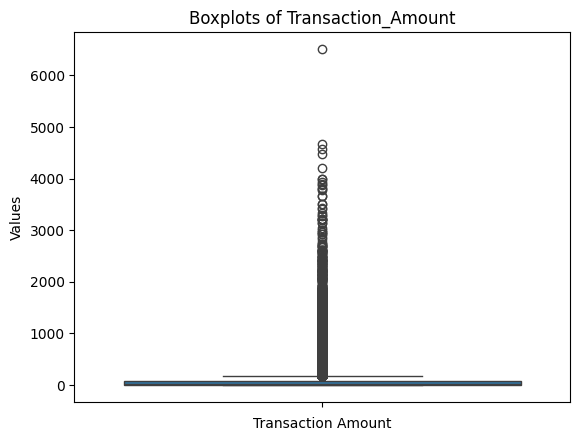

In [23]:
sns.boxplot(df['Transaction_Amount'])
plt.xticks(rotation=90)
plt.title('Boxplots of Transaction_Amount')
plt.xlabel('Transaction Amount')
plt.ylabel('Values')
plt.show()

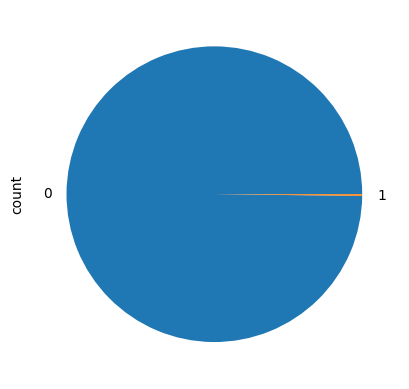

In [24]:
df['IsFraud'].value_counts().plot.pie();

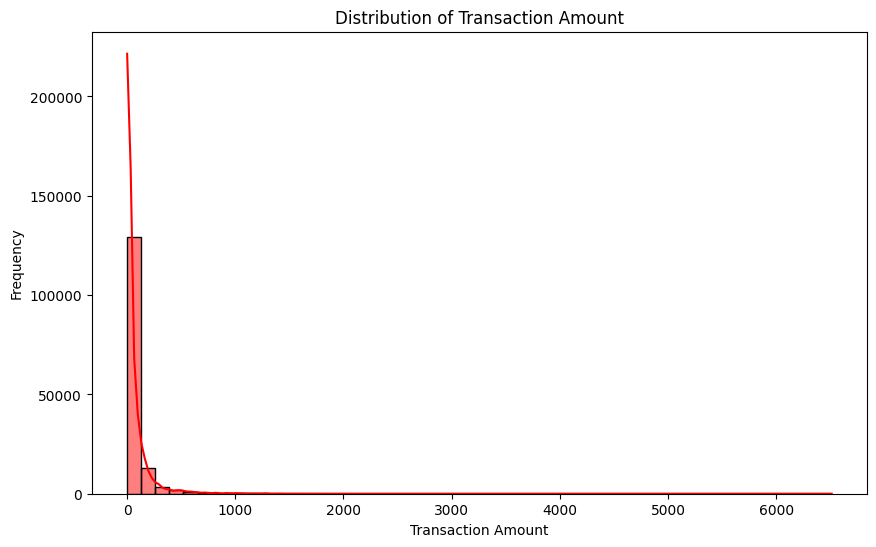

In [25]:
plt.figure(figsize=(10, 6))
sns.histplot(df['Transaction_Amount'], bins=50, kde=True, color='red')
plt.title('Distribution of Transaction Amount')
plt.xlabel('Transaction Amount')
plt.ylabel('Frequency')
plt.show()

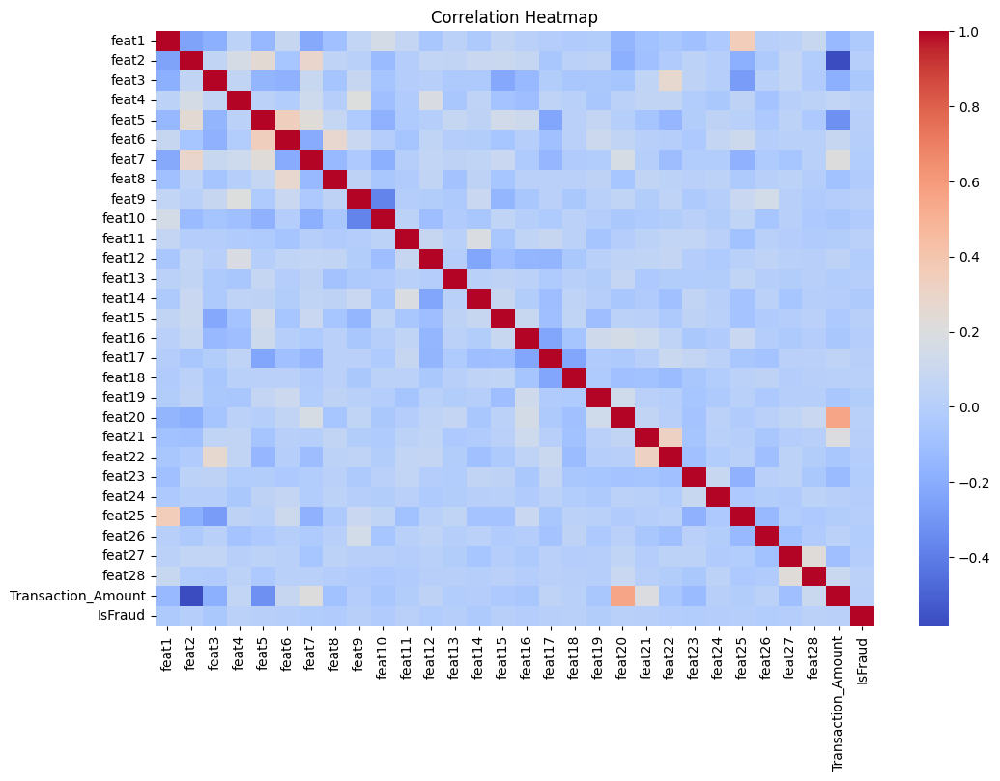

In [26]:
plt.figure(figsize=(12, 8))
correlation_matrix = df.iloc[:, 2:].corr()
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False)
plt.title('Correlation Heatmap')
plt.show()

In [27]:
# target_corr = correlation_matrix['Transaction_Amount'].sort_values(ascending=False)
# target_corr

In [28]:
df_1 = df[df['IsFraud'] == 1]
df_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 269 entries, 1681 to 149812
Data columns (total 32 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  269 non-null    int64  
 1   Time                269 non-null    float64
 2   feat1               269 non-null    float64
 3   feat2               269 non-null    float64
 4   feat3               269 non-null    float64
 5   feat4               269 non-null    float64
 6   feat5               269 non-null    float64
 7   feat6               269 non-null    float64
 8   feat7               269 non-null    float64
 9   feat8               269 non-null    float64
 10  feat9               269 non-null    float64
 11  feat10              269 non-null    float64
 12  feat11              269 non-null    float64
 13  feat12              269 non-null    float64
 14  feat13              269 non-null    float64
 15  feat14              269 non-null    float64
 16  feat15 

In [29]:
df_2 = df[df['IsFraud']== 0].sample(269)
df_2

,id,Time,feat1,feat2,feat3,feat4,feat5,feat6,feat7,feat8,...,feat21,feat22,feat23,feat24,feat25,feat26,feat27,feat28,Transaction_Amount,IsFraud
110078,110078,63356.0,-0.656598,0.988759,1.330856,-0.332817,1.069571,-0.821101,0.597714,-0.161727,...,-0.056869,-0.166789,-0.125588,0.067131,-0.711103,-0.029951,-0.145727,0.118727,0.99,0
135829,135829,70861.0,-0.788447,0.088817,2.208939,-0.696712,-0.848253,0.476917,0.274723,0.387057,...,-0.316136,-0.544878,0.250783,-0.043487,-0.105480,-0.576678,0.162612,0.118366,116.00,0
47799,47799,45253.0,-0.487857,-0.113798,1.068798,-1.694066,-0.565095,-0.890060,-0.225044,0.085878,...,0.312735,0.992430,-0.087779,0.375123,-0.642667,-0.226768,-0.005546,0.139969,33.00,0
56915,56915,48726.0,1.306934,-1.267847,0.706530,-1.328714,-1.596670,-0.330023,-1.090067,-0.159087,...,-0.061479,0.173541,-0.077748,0.066171,0.383776,-0.109775,0.056647,0.038803,82.00,0
123604,123604,67443.0,-0.997768,-1.135769,0.945750,-2.839695,0.955263,3.952739,-1.502913,0.951668,...,-0.140517,0.051268,-0.381736,1.032738,0.707927,-0.051423,0.222844,0.134143,5.00,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127792,127792,68018.0,-1.146581,0.141340,0.696499,1.058246,1.071290,1.046929,-0.236899,0.356949,...,-0.045137,0.261439,-0.378979,-1.109501,-0.153949,-0.216845,-0.183859,-0.158825,9.99,0
139165,139165,71608.0,-0.681835,-0.646616,1.188946,-2.357725,-0.624486,-0.862401,0.149929,-0.042557,...,-0.298055,-0.407025,0.069225,0.090717,-0.011533,-0.413532,0.382378,0.191379,120.31,0
20037,20037,29005.0,-0.778906,2.091813,-0.755513,0.369561,1.098541,-0.872725,1.343618,-0.505869,...,0.017921,0.824786,-0.059126,0.685569,-0.553779,-0.504477,0.584914,0.126888,1.79,0
125006,125006,67590.0,-0.491429,0.879488,1.345029,-0.234598,-0.133700,-0.187728,0.818282,0.127077,...,-0.197385,-0.532696,0.037376,-0.058577,-0.246566,0.072857,0.273315,0.115751,79.99,0


In [30]:
df_3 = pd.concat([df_1,df_2], axis = 0)

In [31]:
df_3

,id,Time,feat1,feat2,feat3,feat4,feat5,feat6,feat7,feat8,...,feat21,feat22,feat23,feat24,feat25,feat26,feat27,feat28,Transaction_Amount,IsFraud
1681,1681,764.0,0.845797,-1.063059,0.120133,-0.312570,-0.056194,1.944391,-0.661839,0.582721,...,-0.430906,-0.919078,0.123612,-1.420935,-0.072559,0.293439,0.061270,0.006448,136.58,1
2039,2039,923.0,-1.808089,1.794735,-2.574549,-1.944174,-4.093440,-1.360198,-8.837694,-3.865127,...,-2.662635,1.173416,-0.136751,0.739760,-0.692745,0.818293,0.745100,0.847648,2.00,1
2090,2090,1028.0,-0.368027,1.492913,0.653399,0.164478,-1.043918,0.766250,-2.717382,-6.944203,...,-0.058687,1.185031,0.290564,0.528459,0.764303,-0.017768,0.110884,0.307835,0.12,1
3072,3072,1328.0,1.990241,-0.185837,-1.039174,0.086245,0.107037,-0.409425,0.016713,-0.126446,...,-0.142725,-0.285513,0.263769,0.779628,-0.261358,0.255895,-0.074999,-0.059828,23.31,1
3780,3780,1438.0,-0.738582,0.654464,0.652465,-0.139933,1.183689,-0.037131,0.638169,0.136502,...,0.167918,0.563421,0.012614,-0.311213,0.105798,-0.252849,0.049231,0.108966,4.99,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127792,127792,68018.0,-1.146581,0.141340,0.696499,1.058246,1.071290,1.046929,-0.236899,0.356949,...,-0.045137,0.261439,-0.378979,-1.109501,-0.153949,-0.216845,-0.183859,-0.158825,9.99,0
139165,139165,71608.0,-0.681835,-0.646616,1.188946,-2.357725,-0.624486,-0.862401,0.149929,-0.042557,...,-0.298055,-0.407025,0.069225,0.090717,-0.011533,-0.413532,0.382378,0.191379,120.31,0
20037,20037,29005.0,-0.778906,2.091813,-0.755513,0.369561,1.098541,-0.872725,1.343618,-0.505869,...,0.017921,0.824786,-0.059126,0.685569,-0.553779,-0.504477,0.584914,0.126888,1.79,0
125006,125006,67590.0,-0.491429,0.879488,1.345029,-0.234598,-0.133700,-0.187728,0.818282,0.127077,...,-0.197385,-0.532696,0.037376,-0.058577,-0.246566,0.072857,0.273315,0.115751,79.99,0


In [32]:
df_3.info()

<class 'pandas.core.frame.DataFrame'>
Index: 538 entries, 1681 to 44940
Data columns (total 32 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  538 non-null    int64  
 1   Time                538 non-null    float64
 2   feat1               538 non-null    float64
 3   feat2               538 non-null    float64
 4   feat3               538 non-null    float64
 5   feat4               538 non-null    float64
 6   feat5               538 non-null    float64
 7   feat6               538 non-null    float64
 8   feat7               538 non-null    float64
 9   feat8               538 non-null    float64
 10  feat9               538 non-null    float64
 11  feat10              538 non-null    float64
 12  feat11              538 non-null    float64
 13  feat12              538 non-null    float64
 14  feat13              538 non-null    float64
 15  feat14              538 non-null    float64
 16  feat15  

In [33]:
df_3['IsFraud'] = df_3['IsFraud'].astype(str)

In [34]:
pd.concat([df_3.iloc[:,12:24], df_3.iloc[:,-1]], axis = 1)

,feat11,feat12,feat13,feat14,feat15,feat16,feat17,feat18,feat19,feat20,feat21,feat22,IsFraud
1681,1.766655,0.826499,-0.307964,0.393909,0.907691,-2.822682,1.055578,-1.061441,-2.138524,-0.569641,-0.430906,-0.919078,1
2039,-1.552959,1.796523,-1.531125,-0.242458,0.926706,0.113577,-0.155949,0.393524,1.085312,1.570826,-2.662635,1.173416,1
2090,1.555025,2.133379,0.125978,1.131705,0.057716,0.944642,-0.440088,0.049590,-0.878509,1.180116,-0.058687,1.185031,1
3072,1.090518,1.617814,0.906706,0.254738,-0.673049,0.193427,-0.771428,-0.214947,0.468155,-0.094906,-0.142725,-0.285513,1
3780,1.039441,0.302428,-1.116929,0.651270,-0.295048,-0.421716,-0.456629,-0.037795,-0.826278,-0.314816,0.167918,0.563421,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
127792,0.013520,0.293523,-0.572527,-0.100691,-0.202499,-0.567272,-0.055721,0.272415,1.081859,-0.254570,-0.045137,0.261439,0
139165,-0.788393,-1.869363,-0.817592,-0.294823,0.310564,-0.624882,0.639391,-0.423599,-0.824142,-0.331236,-0.298055,-0.407025,0
20037,-0.441870,0.296704,0.924666,-0.152889,0.475668,-0.914383,-0.461877,-0.272435,0.181657,0.879553,0.017921,0.824786,0
125006,1.062159,0.135500,-0.690165,0.457765,0.270854,0.373727,-0.624093,0.202298,0.232408,0.249881,-0.197385,-0.532696,0


In [35]:
sns.pairplot(df_3.iloc[:,2:], hue='IsFraud')
plt.show()

In [36]:
sns.pairplot(df_3.iloc[:,1:], hue='IsFraud')
plt.show()

Из диаграммы рассеяния выше видно, линейных резделяющих плоскостей между fraud и не fraud нету, но есть закономерность что распределение на диаграмах рассеяньях fraid - 1 хоатичнее чем в отсутсвии fraud

Благодоря этому мы можем построить модели на основе SVM c радиальным базисным ядром

Так же будем пробовать обучение с учителем и обучение без учителя.

In [37]:
x = df.drop(['id', 'IsFraud'], axis = 1)
y = df['IsFraud']

In [38]:
scaler = StandardScaler()

x_scaled = scaler.fit_transform(x)

In [39]:
svm = OneClassSVM()

In [40]:
svm.fit(x_scaled)

OneClassSVM()

In [41]:

joblib.dump(svm, 'svm_model.dump')

['svm_model.dump']

In [42]:
svm = joblib.load('svm_model.dump')

In [43]:
y_pred = svm.predict(x_scaled)



In [44]:
y_pred_1 = (y_pred == -1).astype(int)

In [45]:
y_pred_1

array([1, 1, 1, ..., 0, 1, 1], shape=(150000,))

In [46]:
print(classification_report(y, y_pred_1))

              precision    recall  f1-score   support

           0       1.00      0.50      0.67    149731
           1       0.00      0.80      0.01       269

    accuracy                           0.50    150000
   macro avg       0.50      0.65      0.34    150000
weighted avg       1.00      0.50      0.67    150000



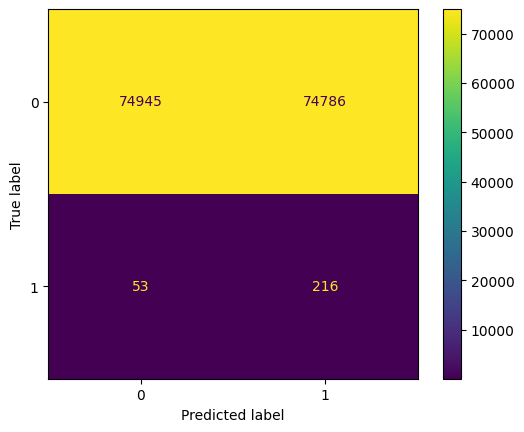

In [47]:
ConfusionMatrixDisplay.from_predictions(y, y_pred_1)

In [48]:
isol_forest = IsolationForest(random_state=1234, n_estimators= 1000)

isol_forest.fit(x_scaled)


IsolationForest(n_estimators=1000, random_state=1234)

In [49]:
y_pred = isol_forest.predict(x_scaled)

In [50]:
y_pred

array([1, 1, 1, ..., 1, 1, 1], shape=(150000,))

In [51]:
y_pred_1 = (y_pred == -1).astype(int)

In [52]:
print(classification_report(y, y_pred_1))

              precision    recall  f1-score   support

           0       1.00      0.97      0.98    149731
           1       0.02      0.33      0.03       269

    accuracy                           0.96    150000
   macro avg       0.51      0.65      0.51    150000
weighted avg       1.00      0.96      0.98    150000



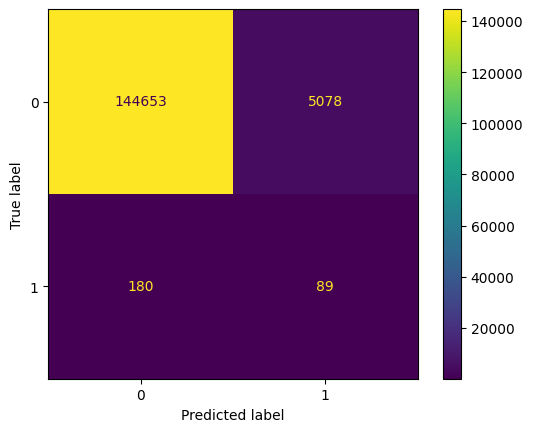

In [53]:
ConfusionMatrixDisplay.from_predictions(y, y_pred_1)

In [54]:
lof = LocalOutlierFactor()

y_pred = lof.fit_predict(x_scaled)
y_pred

c:\Users\Admin\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\Admin\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
        "wmic CPU Get NumberOfCores /Format:csv".split(),
        capture_output=True,
        text=True,
    )
  File "c:\Users\Admin\AppData\Local\Programs\Python\Python313\Lib\subprocess.py", line 554, in run
    with Popen(*popenargs, **kwargs) as process:
         ~~~~~^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Admin\AppData\Local\Programs\Python\Python313\Lib\subprocess.py", line 1036

array([1, 1, 1, ..., 1, 1, 1], shape=(150000,))

In [55]:
y_pred_1 = (y_pred == -1).astype(int)

In [56]:
print(classification_report(y, y_pred_1))

              precision    recall  f1-score   support

           0       1.00      0.96      0.98    149731
           1       0.01      0.22      0.02       269

    accuracy                           0.95    150000
   macro avg       0.50      0.59      0.50    150000
weighted avg       1.00      0.95      0.98    150000



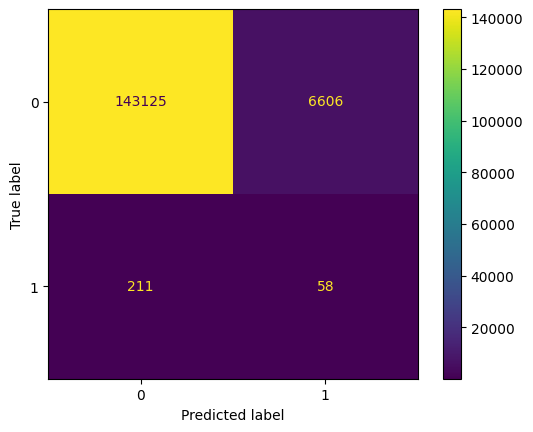

In [57]:
ConfusionMatrixDisplay.from_predictions(y, y_pred_1)

In [58]:
269/149731

0.001796555155579005

In [59]:
def objective(trial):
    params = {
        "bootstrap":trial.suggest_categorical('bootstrap', choices = [True, False]),
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000, step= 100),
        "contamination": trial.suggest_categorical("contamination", choices = [0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 'auto'])
    }
    
    isol_forest = IsolationForest(random_state=1234, **params)

    isol_forest.fit(x_scaled)
    
    y_pred = isol_forest.predict(x_scaled)
    
    y_pred_1 = (y_pred == -1).astype(int)
    
    tn, fp, fn, tp = confusion_matrix(y_pred=y_pred_1, y_true=y).ravel()
   
    return fn

In [60]:

study = optuna.create_study(direction='minimize')

study.optimize(objective ,n_trials=50,n_jobs=-1)

trial = study.best_trial

print("FN: {}".format(trial.value)) 
print("Best hyperparameters: {}".format(trial.params))

[I 2025-01-10 11:13:24,298] A new study created in memory with name: no-name-6e73b431-fd51-4946-8dd2-e81b6568f6bf
[I 2025-01-10 11:13:30,330] Trial 1 finished with value: 141.0 and parameters: {'bootstrap': True, 'n_estimators': 100, 'contamination': 0.1}. Best is trial 1 with value: 141.0.
[I 2025-01-10 11:13:30,339] Trial 15 finished with value: 242.0 and parameters: {'bootstrap': True, 'n_estimators': 100, 'contamination': 0.005}. Best is trial 1 with value: 141.0.
[I 2025-01-10 11:13:30,350] Trial 0 finished with value: 225.0 and parameters: {'bootstrap': False, 'n_estimators': 100, 'contamination': 0.01}. Best is trial 1 with value: 141.0.
[I 2025-01-10 11:13:31,964] Trial 11 finished with value: 177.0 and parameters: {'bootstrap': True, 'n_estimators': 200, 'contamination': 'auto'}. Best is trial 1 with value: 141.0.
[I 2025-01-10 11:13:39,661] Trial 2 finished with value: 152.0 and parameters: {'bootstrap': True, 'n_estimators': 300, 'contamination': 0.1}. Best is trial 1 with v

FN: 141.0
Best hyperparameters: {'bootstrap': True, 'n_estimators': 100, 'contamination': 0.1}


In [61]:
# Best hyperparameters: {'bootstrap': False, 'n_estimators': 100, 'contamination': 0.1}

isol_forest = IsolationForest(random_state=1234, bootstrap= False, n_estimators = 100, contamination = 0.1)

isol_forest.fit(x_scaled)

y_pred = isol_forest.predict(x_scaled)

y_pred_1 = (y_pred == -1).astype(int)

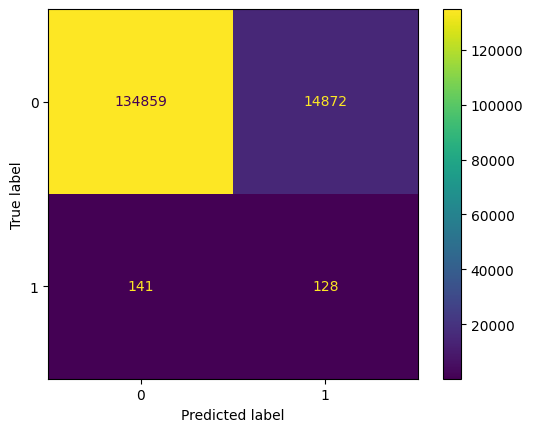

In [62]:
ConfusionMatrixDisplay.from_predictions(y, y_pred_1)

In [63]:
def objective(trial):
    params = {
        "n_neighbors": trial.suggest_int("n_neighbors", 5,50),
        "leaf_size": trial.suggest_int("leaf_size", 5, 50),
        "contamination": trial.suggest_categorical("contamination", choices = [0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 'auto'])
    }
    
    
    lof = LocalOutlierFactor(**params)

    
    y_pred = lof.fit_predict(x_scaled)
    
    y_pred_1 = (y_pred == -1).astype(int)
    
    tn, fp, fn, tp = confusion_matrix(y_pred=y_pred_1, y_true=y).ravel()
   
    return fn

In [64]:
import os 
os.environ['LOKY_MAX_CPU_COUNT'] = '6'

In [33]:

study = optuna.create_study(direction='minimize')

study.optimize(objective ,n_trials=30,n_jobs=4)

trial = study.best_trial

print("FN: {}".format(trial.value)) 
print("Best hyperparameters: {}".format(trial.params))

[I 2025-01-10 11:14:44,913] A new study created in memory with name: no-name-96961e80-b8b8-48e5-a16e-e6d30d5525d3
[I 2025-01-10 11:15:19,246] Trial 3 finished with value: 257.0 and parameters: {'n_neighbors': 12, 'leaf_size': 41, 'contamination': 0.005}. Best is trial 3 with value: 257.0.
[I 2025-01-10 11:15:21,059] Trial 2 finished with value: 214.0 and parameters: {'n_neighbors': 15, 'leaf_size': 44, 'contamination': 'auto'}. Best is trial 2 with value: 214.0.
